# Week 6 Challenge


# Challenge 1: Geodemographic Classification

In this challenge, you will replicate the process of creating a geodemographic classification using the k-means clustering algorithm. Please select any city in the UK except London, Liverpool, or Glasgow. The main goal is to generate a meaningful and informative classification that captures the diversity of areas in your dataset using the census data ( For England, you can try to use the 2021 or 2011 census, and for Scotland, you need to use the 2011 census data) 

1. Define the main goal for the geodemographic classification (marketing, retail and service planning). 
2. Look for census data from the selected city for which you would like to generate the geodemographic classification.
3. The census data at the Output Area OA level. Select multiple topics of at least four topics (socio-demographics, economics, health, and so on). Describe your topic selection accordingly based on the goal of your geodemographic classification. For example, if your geodemographics are related to marketing, Economic variables might be the appropriate selection. 
4. Identify the variables that will be crucial for effectively segmenting neighbourhoods. Evaluate how this choice may impact the classification results, including a DEA analysis.
5. Prepare, adjust or clean the dataset addressing any missing values or outliers that could distort the clustering results.
6. Include standardisation between areas and variables. Make an appropriate analysis and adjust the variable selection accordingly for any multicollinearity.
7. Utilize the k-means clustering algorithm to create a classification based on the selected variables.
8. Define the optimum number of clusters (i.e., using the Elblow method). Experiment with different values of k.
9. Evaluate your cluster groups (e.g., using PCA) and interpret your cluster centres. Describe your results and repeat the process to adjust the variable selection and cluster groups to provide more meaningful results for your geodemographic goal. Interpret the characteristics of each cluster. What demographic patterns or similarities are prevalent within each group?
10. Map the final cluster groups
11. Finish the analysis by naming the final clusters and plotting a final map that includes the census values and the provided names.
12. Finally, acknowledge the subjective nature of classification and make analytical decisions to produce an optimum classification for your specific purpose. Reflect on the challenges and insights gained during the classification process. Ensure you document your analytical decisions and the rationale behind any important decision. Once your geodemographics are constructed, describe the potential use cases for the geodemographic classification you have built based on your initial goal.

In [1]:
#?KMeans # Uncomment and run to enable kmeans for this challenge.

### From the 2021 census, I am going to use Cardiff.
The goal from the geodemographic classification is to evaluate service planning in Cardiff by Welsh speakers and identity.
Use TS027 - National identity - UK, TS035 - Welsh language skills (reading), TS036 - Welsh language skills (understanding) and TS005 - Passports held (where I am doing percentage that holds a UK passport or no passport).

I chose these as I wanted to see how the percentage of those who identify as either Welsh or British, Those with Welsh language skills in both reading and understanding and those who hold a UK passport (assuming those who do not are not British) should dictate the provision of Welsh language services.

In [2]:
# To merge the data
import pandas as pd
import os
import geopandas as gpd

csv_directory = "data_lab6/challenge_raw_data/"

# We need a list of all CSV files in the folder
csv_files = [file for file in os.listdir(csv_directory) if file.endswith(".csv")]

# An empty DataFrame to store the merged data
merged_data = pd.DataFrame()

# Loop through each CSV file
for csv_file in csv_files:
    csv_path = os.path.join(csv_directory, csv_file) # We create a consistent path
    df_csv = pd.read_csv(csv_path, low_memory=False) #read each file
    # Concatenate/Merge all columns, there is a pitfall here, you will get a duplicate oa_code from all csv files.
    merged_data = pd.concat([merged_data, df_csv], axis=1)

# Save the merged dataset.
merged_data.to_csv("data_lab6/challenge_processed_data/merged_census_data.csv", index=False)

In [3]:
# Output areas from https://geoportal.statistics.gov.uk/datasets/31dac98df61a4312991646842b147e2f_0/explore?location=51.633296%2C-2.943884%2C9.98
# Use subset_data to create a subset of Cardiff
# Large file needs to be downloaded first
# Following 3 lines are url request. Remove if they fail (and place the file manually).
import urllib.request
url = "https://owncloud.andrewwhite.uk/s/6BqwJuOPbksDk88/download" # Using my personal cloud server at home to serve links as onedrive direct links do not work properly. May take time to download (I have ~80mbps upload).
urllib.request.urlretrieve(url, "data_lab6/challenge_raw_data/OA_2021_EW_BFC_V8.shp") # save it to the correct place.

#If url fails, comment out URL lines, add the file as in the readme and continue from here.

shp_all_oa = "data_lab6/challenge_raw_data/OA_2021_EW_BFC_V8.shp"
gdf_all_oa = gpd.read_file(shp_all_oa)

In [4]:
# Now read the column names and get rid of all those outside Cardiff
# Cardiff should be in LSOA21NM
gdf_oa_filtered = gdf_all_oa[gdf_all_oa["LSOA21NM"].str.contains("Cardiff", na=False)] # remove all columns that dont include Cardiff
gdf_oa_filtered.head() # All LSOA21NMs outwith Cardiff have been removed
gdf_oa_filtered.to_file('data_lab6/challenge_raw_data/cardiff_census_data.shp', index=False) # Save the Cardiff only data.

In [5]:
gdf_oa_filtered.head()


,OA21CD,LSOA21CD,LSOA21NM,LSOA21NMW,BNG_E,BNG_N,LAT,LONG,GlobalID,geometry
187078,W00008779,W01001694,Cardiff 036A,Caerdydd 036A,319717,177053,51.4867,-3.15765,45935cda-b2a5-4103-b6a7-3b349972886d,"POLYGON ((319989.873 176997.771, 319972.767 17..."
187079,W00008780,W01001697,Cardiff 036D,Caerdydd 036D,320018,177178,51.4879,-3.15334,72e459d5-77e2-4765-9939-8874e049b212,"POLYGON ((320049.851 177250.509, 320052.056 17..."
187080,W00008781,W01001694,Cardiff 036A,Caerdydd 036A,319566,177006,51.4863,-3.15981,62dd9689-45bd-47e1-8133-0a1c03f26763,"POLYGON ((319653.520 177024.966, 319650.532 17..."
187081,W00008782,W01001694,Cardiff 036A,Caerdydd 036A,319789,176962,51.4859,-3.15659,85c9cf59-8d05-4477-8d15-887151c9eae2,"POLYGON ((319906.567 176957.413, 319906.492 17..."
187082,W00008784,W01001694,Cardiff 036A,Caerdydd 036A,319925,176862,51.4850,-3.15461,beb65b41-1085-46e6-9e68-2492d73b2c54,"POLYGON ((319989.873 176997.771, 319990.658 17..."


In [6]:
# Now, use gdf_oa_filtered and the processed data.

csv_path = "data_lab6/challenge_processed_data/merged_census_data.csv"
csv_data = pd.read_csv(csv_path, low_memory=False)

# Merge the GeoDataFrame with the DataFrame based on the oa_code
merged_data_cardiff = gdf_oa_filtered.merge(csv_data, left_on='OA21CD', right_on='mnemonic', how='left')
# Check for NA values
print(merged_data_cardiff.isna().sum()) # List all NA values. Here, there are no No NA values.
merged_data_cardiff.to_file('data_lab6/challenge_processed_data/cardiff_census_data.shp', index=False)

OA21CD                               0
LSOA21CD                             0
LSOA21NM                             0
LSOA21NMW                            0
BNG_E                                0
BNG_N                                0
LAT                                  0
LONG                                 0
GlobalID                             0
geometry                             0
2021 output area                     0
mnemonic                             0
Cannot understand spoken Welsh       0
% Cannot understand spoken Welsh     0
Can understand spoken Welsh          0
% Can understand spoken Welsh        0
2021 output area.1                   0
mnemonic.1                           0
Europe: United Kingdom               0
% Europe: United Kingdom             0
No passport held                     0
% No passport held                   0
combined uk                          0
% combined uk                        0
2021 output area.2                   0
mnemonic.2               

C:\Users\Andrew White\AppData\Local\Temp\ipykernel_30880\3951629091.py:10: UserWarning: Column names longer than 10 characters will be truncated when saved to ESRI Shapefile.
  merged_data_cardiff.to_file('data_lab6/challenge_processed_data/cardiff_census_data.shp', index=False)


In [7]:
list(merged_data_cardiff.columns)

['OA21CD',
 'LSOA21CD',
 'LSOA21NM',
 'LSOA21NMW',
 'BNG_E',
 'BNG_N',
 'LAT',
 'LONG',
 'GlobalID',
 'geometry',
 '2021 output area',
 'mnemonic',
 'Cannot understand spoken Welsh',
 '% Cannot understand spoken Welsh',
 'Can understand spoken Welsh',
 '% Can understand spoken Welsh',
 '2021 output area.1',
 'mnemonic.1',
 'Europe: United Kingdom',
 '% Europe: United Kingdom',
 'No passport held',
 '% No passport held',
 'combined uk',
 '% combined uk',
 '2021 output area.2',
 'mnemonic.2',
 'Cannot read Welsh',
 '% cannot read Welsh',
 'Can read Welsh',
 '% Can read Welsh',
 '2021 output area.3',
 'mnemonic.3',
 'Welsh only identity',
 '% Welsh only identity',
 'Welsh and British only identity',
 '% Welsh and British only identity',
 'Combined Welsh and British',
 '% Combined Welsh and British']

For what I am wanting to find out, the essential variables are % Combined Welsh and British, % combined uk (either UK or no passport), % Can understand spoken Welsh and % Can read Welsh. I am aware that multicollinearity could be an issue though. This choice is going to classify each neighbourhood by how many people are legally "British" (either with a British passport or, no passport), how many see themselves as Welsh and British and Welsh language understanding.

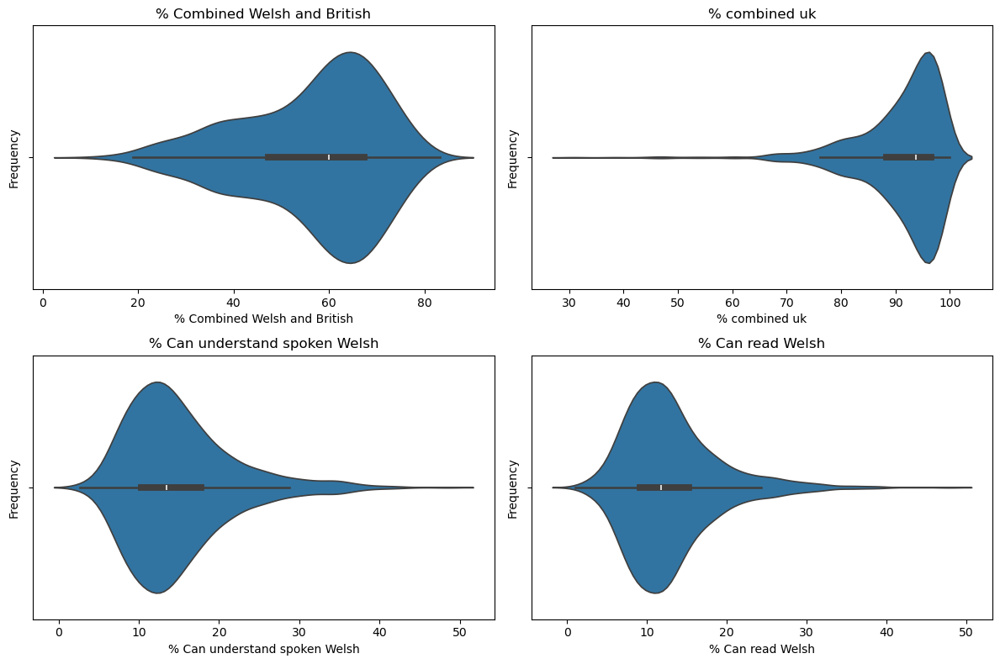

In [8]:
# Plot some of my chosen variables- % Combined Welsh and British, % combined uk (either UK or no passport), 
# % Can understand spoken Welsh and % Can read Welsh
import seaborn as sns
import matplotlib.pyplot as plt

attributes_to_plot = ['% Combined Welsh and British',
                      '% combined uk',
                      '% Can understand spoken Welsh',
                      '% Can read Welsh']

plt.figure(figsize=(12, 8))

for i, attribute in enumerate(attributes_to_plot, 1):
    plt.subplot(2, 2, i)
    sns.violinplot(x=merged_data_cardiff[attribute])
    plt.title(attribute)
    plt.ylabel('Frequency')
    

plt.tight_layout()
plt.show()

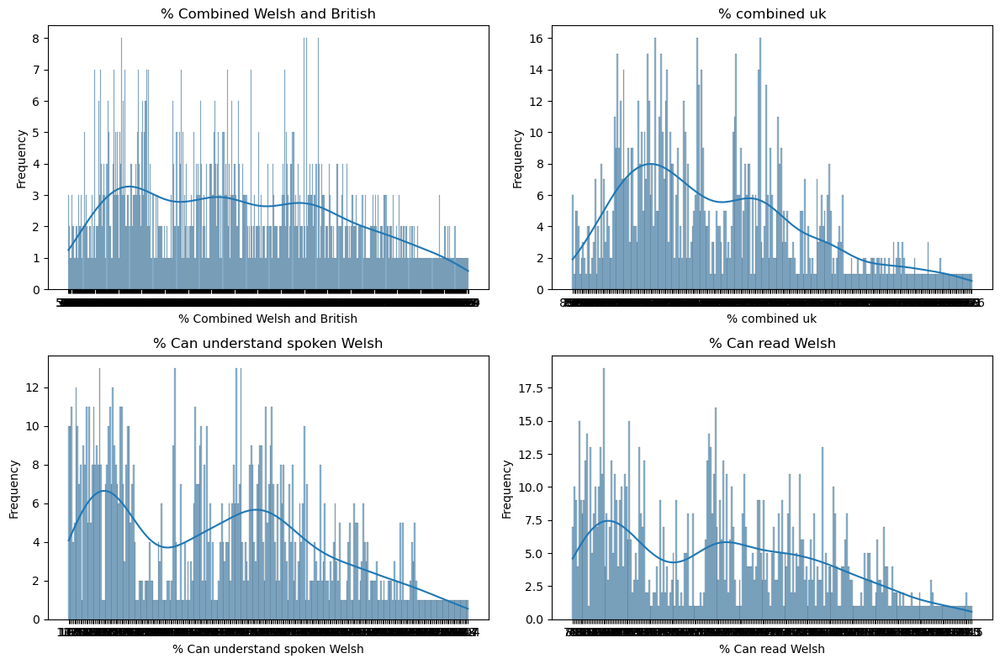

In [9]:
# More plots
attributes_to_plot = ['% Combined Welsh and British',
                      '% combined uk',
                      '% Can understand spoken Welsh',
                      '% Can read Welsh']

plt.figure(figsize=(12, 8))

for i, attribute in enumerate(attributes_to_plot, 1):
    plt.subplot(2, 2, i)
    sns.histplot(merged_data_cardiff[attribute].astype(str), kde=True)
    plt.title(attribute)
    plt.ylabel('Frequency')
plt.tight_layout()
plt.show()

In [10]:
# I do not need to find out the percentages as I downloaded data with percentages included.
# I have checked for missing data already. There also does not seem to be any significant outliers in my percentages.
# Due to it being in percentages, everything is standardized.

In [11]:
# Calculate the Z scores
numeric_columns = merged_data_cardiff.select_dtypes(include='float64')
z_score_df = (numeric_columns - numeric_columns.mean()) / numeric_columns.std(ddof=0)
z_score_df.head()

,LAT,LONG,% Cannot understand spoken Welsh,% Can understand spoken Welsh,% Europe: United Kingdom,% No passport held,% combined uk,% cannot read Welsh,% Can read Welsh,% Welsh only identity,% Welsh and British only identity,% Combined Welsh and British
0,-0.665229,0.668602,0.337766,-0.337766,-0.543159,0.556259,-0.173298,0.925610,-0.925610,-0.416569,0.119635,-0.346402
1,-0.609926,0.764464,0.488350,-0.488350,-2.182029,0.936485,-1.875085,0.736844,-0.736844,-1.079546,-1.258391,-1.256121
2,-0.683664,0.620560,0.578700,-0.578700,-1.323103,0.271090,-1.406477,0.856968,-0.856968,-0.985950,-1.411505,-1.207136
3,-0.702099,0.692178,1.346675,-1.346675,-1.846357,1.303130,-1.122846,1.371786,-1.371786,-0.946951,-1.166523,-1.116164
4,-0.743576,0.736217,0.819633,-0.819633,-1.224376,0.216772,-1.332486,0.839807,-0.839807,-1.547530,-0.829672,-1.578021


In [12]:
keep_cols= [
 'OA21CD',
 'LSOA21CD',
 'LSOA21NM',
 'LSOA21NMW',
 'GlobalID',
 'geometry',
 '2021 output area',
 '% Cannot understand spoken Welsh',
 '% Can understand spoken Welsh',
 '% combined uk',
 '% cannot read Welsh',
 '% Can read Welsh',
 '% Welsh only identity',
 '% Welsh and British only identity',
 '% Combined Welsh and British'
]

cardiff_census_data = merged_data_cardiff[keep_cols]

In [13]:
# Short column names for manipulation
short_column_names = {
    '% Cannot understand spoken Welsh': 'No_Spoken_Welsh',
    '% Can understand spoken Welsh': 'Spoken_Welsh',
    '% combined uk': '%_UK',
    '% cannot read Welsh': 'No_Read_Welsh',
    '% Can read Welsh': 'Read_Welsh',
    '% Welsh only identity': 'Only_Welsh',
    '% Welsh and British only identity': 'Welsh_and_British',
    '% Combined Welsh and British': 'Welsh_only_and_Welsh_British'
}

cardiff_census_data = cardiff_census_data.rename(columns=short_column_names)


In [14]:
cardiff_census_data.head() # Correctly kept the data I wanted.

,OA21CD,LSOA21CD,LSOA21NM,LSOA21NMW,GlobalID,geometry,2021 output area,No_Spoken_Welsh,Spoken_Welsh,%_UK,No_Read_Welsh,Read_Welsh,Only_Welsh,Welsh_and_British,Welsh_only_and_Welsh_British
0,W00008779,W01001694,Cardiff 036A,Caerdydd 036A,45935cda-b2a5-4103-b6a7-3b349972886d,"POLYGON ((319989.873 176997.771, 319972.767 17...",W00008779,87.3,12.7,89.7,92.5,7.5,42.4,9.2,51.6
1,W00008780,W01001697,Cardiff 036D,Caerdydd 036D,72e459d5-77e2-4765-9939-8874e049b212,"POLYGON ((320049.851 177250.509, 320052.056 17...",W00008780,88.3,11.7,75.9,91.4,8.6,33.9,4.7,38.6
2,W00008781,W01001694,Cardiff 036A,Caerdydd 036A,62dd9689-45bd-47e1-8133-0a1c03f26763,"POLYGON ((319653.520 177024.966, 319650.532 17...",W00008781,88.9,11.1,79.7,92.1,7.9,35.1,4.2,39.3
3,W00008782,W01001694,Cardiff 036A,Caerdydd 036A,85c9cf59-8d05-4477-8d15-887151c9eae2,"POLYGON ((319906.567 176957.413, 319906.492 17...",W00008782,94.0,6.0,82.0,95.1,4.9,35.6,5.0,40.6
4,W00008784,W01001694,Cardiff 036A,Caerdydd 036A,beb65b41-1085-46e6-9e68-2492d73b2c54,"POLYGON ((319989.873 176997.771, 319990.658 17...",W00008784,90.5,9.5,80.3,92.0,8.0,27.9,6.1,34.0


In [15]:
# For the multicollinearity, find the z score for each float variable
numeric_columns = cardiff_census_data.select_dtypes(include='float64') # float only
z_score_df_cardiff = (numeric_columns - numeric_columns.mean()) / numeric_columns.std(ddof=0)
z_score_df_cardiff.head()

,No_Spoken_Welsh,Spoken_Welsh,%_UK,No_Read_Welsh,Read_Welsh,Only_Welsh,Welsh_and_British,Welsh_only_and_Welsh_British
0,0.337766,-0.337766,-0.173298,0.925610,-0.925610,-0.416569,0.119635,-0.346402
1,0.488350,-0.488350,-1.875085,0.736844,-0.736844,-1.079546,-1.258391,-1.256121
2,0.578700,-0.578700,-1.406477,0.856968,-0.856968,-0.985950,-1.411505,-1.207136
3,1.346675,-1.346675,-1.122846,1.371786,-1.371786,-0.946951,-1.166523,-1.116164
4,0.819633,-0.819633,-1.332486,0.839807,-0.839807,-1.547530,-0.829672,-1.578021


In [16]:
# Initial Z score matrix
corr_cardiff = z_score_df_cardiff.corr()
corr_cardiff.style.background_gradient(cmap='coolwarm')

,No_Spoken_Welsh,Spoken_Welsh,%_UK,No_Read_Welsh,Read_Welsh,Only_Welsh,Welsh_and_British,Welsh_only_and_Welsh_British
No_Spoken_Welsh,1.000000,-1.000000,-0.290440,0.950914,-0.950914,-0.190798,-0.140493,-0.203287
Spoken_Welsh,-1.000000,1.000000,0.290440,-0.950914,0.950914,0.190798,0.140493,0.203287
%_UK,-0.290440,0.290440,1.000000,-0.228585,0.228585,0.730102,0.462681,0.760770
No_Read_Welsh,0.950914,-0.950914,-0.228585,1.000000,-1.000000,-0.110805,-0.089398,-0.119842
Read_Welsh,-0.950914,0.950914,0.228585,-1.000000,1.000000,0.110805,0.089398,0.119842
Only_Welsh,-0.190798,0.190798,0.730102,-0.110805,0.110805,1.000000,0.348332,0.976789
Welsh_and_British,-0.140493,0.140493,0.462681,-0.089398,0.089398,0.348332,1.000000,0.541036
Welsh_only_and_Welsh_British,-0.203287,0.203287,0.760770,-0.119842,0.119842,0.976789,0.541036,1.000000


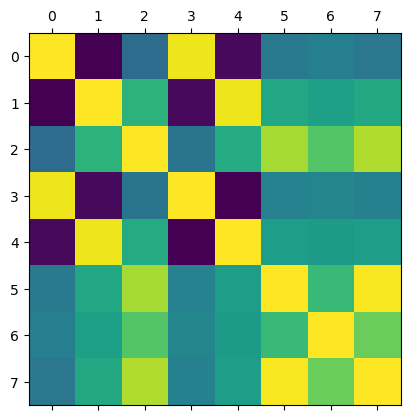

In [17]:
# matrix for highly correlated values
import matplotlib.pyplot as plt

plt.matshow(z_score_df_cardiff.corr())
plt.show()

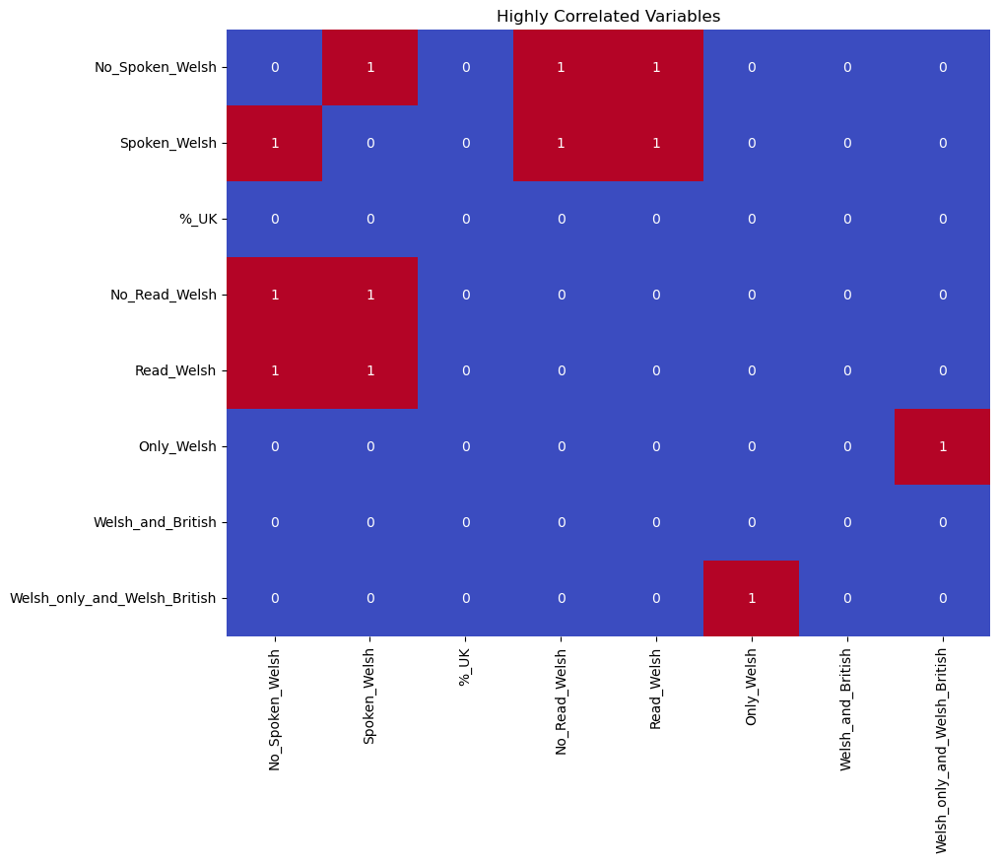

In [18]:
threshold = 0.8 # Threshold to 80% as that is standard and variables are removed.

highly_correlated_cardiff = (corr_cardiff.abs() > threshold) & (corr_cardiff.abs() < 1.0)

plt.figure(figsize=(10, 8))
sns.heatmap(highly_correlated_cardiff, cmap='coolwarm', cbar=False, annot=True)

plt.title('Highly Correlated Variables')
plt.show()


In [19]:
# remove highly correlated values and try again
z_score_df_cardiff.drop(['Spoken_Welsh', 'No_Spoken_Welsh', 'No_Read_Welsh', 'Only_Welsh'], axis=1, inplace=True)
corr_2_cardiff = z_score_df_cardiff.corr() # Create new correlation matrix
corr_2_cardiff.style.background_gradient(cmap='coolwarm') 

,%_UK,Read_Welsh,Welsh_and_British,Welsh_only_and_Welsh_British
%_UK,1.000000,0.228585,0.462681,0.760770
Read_Welsh,0.228585,1.000000,0.089398,0.119842
Welsh_and_British,0.462681,0.089398,1.000000,0.541036
Welsh_only_and_Welsh_British,0.760770,0.119842,0.541036,1.000000


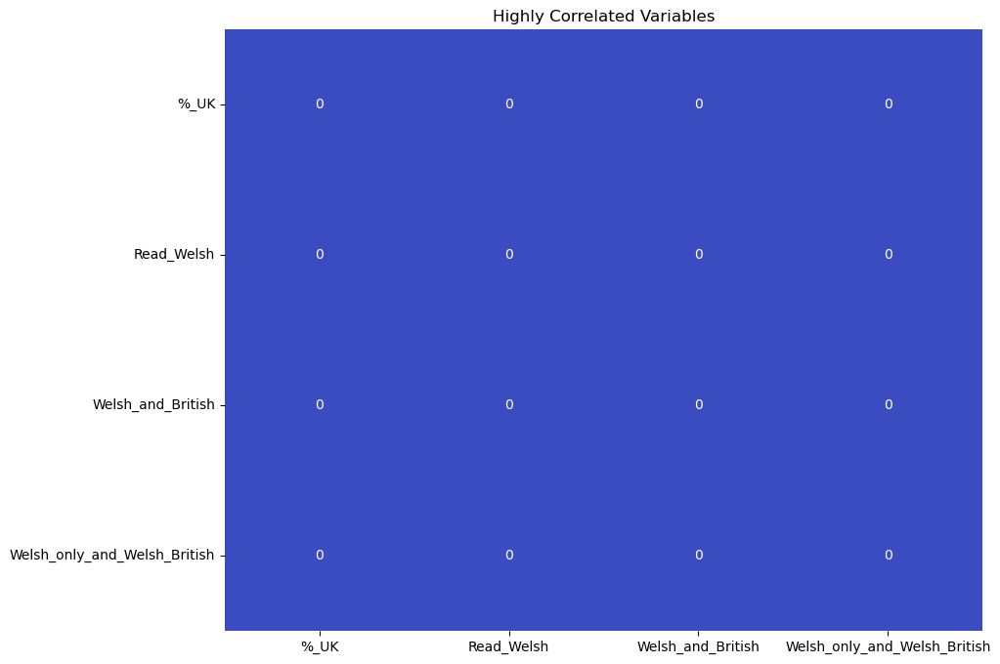

In [20]:
#New map for highly correlated
threshold = 0.8 # Threshold to 80% as that is standard and variables are removed.

highly_correlated_cardiff2 = (corr_2_cardiff.abs() > threshold) & (corr_2_cardiff.abs() < 1.0)

plt.figure(figsize=(10, 8))
sns.heatmap(highly_correlated_cardiff2, cmap='coolwarm', cbar=False, annot=True)

plt.title('Highly Correlated Variables')
plt.show() # Not highly correlated anymore.

In [21]:
# Find out if there is Na values
contains_nan = z_score_df_cardiff.isna().any().any()

if contains_nan:
    print("Na values present.")
else:
    print("No Na Values present.")

No Na Values present.


In [22]:
# Create a KMeans with 10 clusters
from sklearn.cluster import KMeans
from scipy.spatial.distance import cdist, pdist

kmeans = KMeans(n_clusters=10)
kmeans.fit(z_score_df_cardiff)
labels = kmeans.predict(z_score_df_cardiff)
cluster_centres = kmeans.cluster_centers_
z_score_df_cardiff['Cluster'] = kmeans.labels_

C:\Applications\miniforge\envs\ua\Lib\site-packages\sklearn\cluster\_kmeans.py:1419: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=5.
  warnings.warn(


(array([147.,  80., 104., 130., 119., 107.,  75., 106.,  42., 205.]),
 array([0. , 0.9, 1.8, 2.7, 3.6, 4.5, 5.4, 6.3, 7.2, 8.1, 9. ]),
 <BarContainer object of 10 artists>)

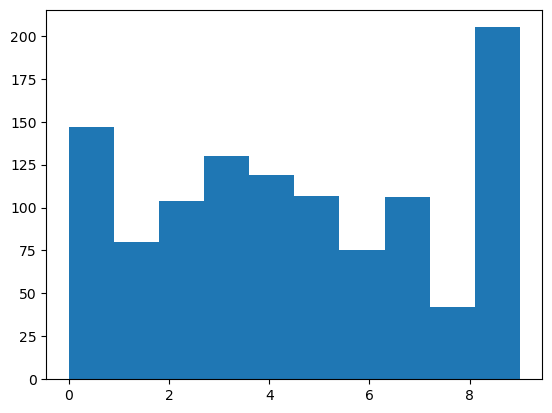

In [23]:
plt.hist(labels) # Plot the KMeans as a histogram.

C:\Applications\miniforge\envs\ua\Lib\site-packages\sklearn\cluster\_kmeans.py:1419: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=5.
  warnings.warn(
C:\Applications\miniforge\envs\ua\Lib\site-packages\sklearn\cluster\_kmeans.py:1419: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=5.
  warnings.warn(
C:\Applications\miniforge\envs\ua\Lib\site-packages\sklearn\cluster\_kmeans.py:1419: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=5.
  warnings.warn(
C:\Applications\miniforge\envs\ua\Lib\site-packages\sklearn\cluster\_kmeans.py:1419: UserWarning: KMeans is k

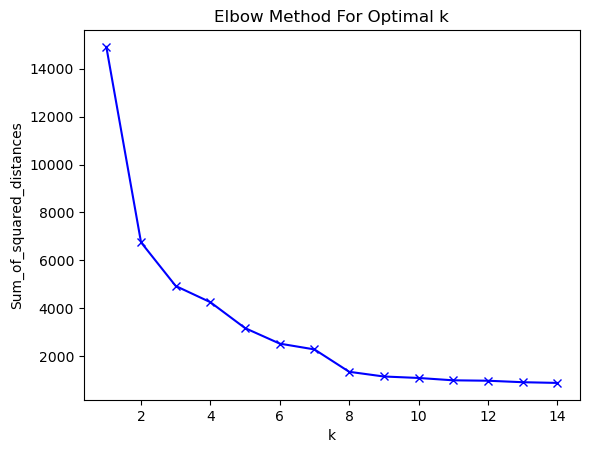

In [24]:
# Now for the optimal number of clusters
Sum_of_squared_distances = []

K_range = range(1,15)

for k in K_range:
 km = KMeans(n_clusters=k)
 km = km.fit(z_score_df_cardiff)
 Sum_of_squared_distances.append(km.inertia_)
    
plt.plot(K_range, Sum_of_squared_distances, 'bx-')
plt.xlabel('k')
plt.ylabel('Sum_of_squared_distances')
plt.title('Elbow Method For Optimal k')
plt.show()

In [25]:
# From this, the elbow is around k = 4.
# KMeans with 4 clusters, after the validation with the Elbow method.
kmeans = KMeans(n_clusters=4)
kmeans.fit(z_score_df_cardiff)
labels = kmeans.predict(z_score_df_cardiff)
cluster_centres = kmeans.cluster_centers_

z_score_df_cardiff['Cluster'] = kmeans.labels_

C:\Applications\miniforge\envs\ua\Lib\site-packages\sklearn\cluster\_kmeans.py:1419: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=5.
  warnings.warn(


C:\Applications\miniforge\envs\ua\Lib\site-packages\sklearn\cluster\_kmeans.py:1419: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=5.
  warnings.warn(


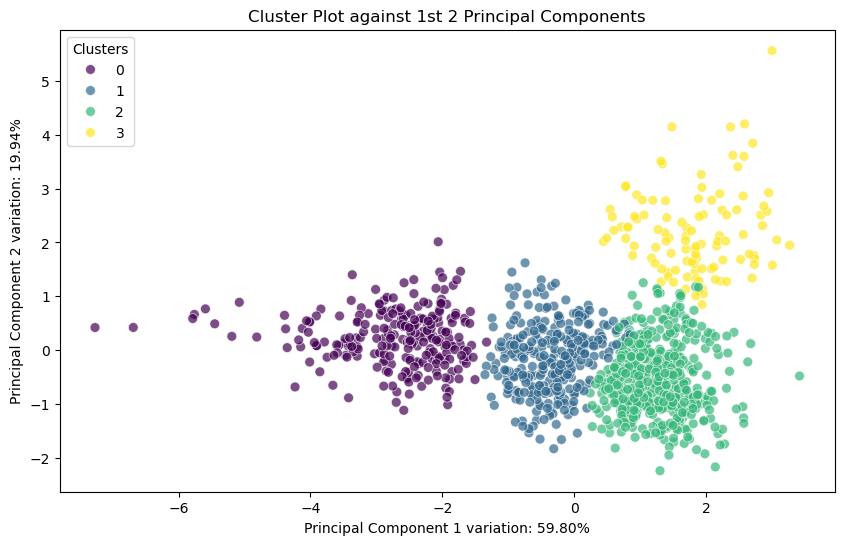

In [26]:
# Doing a PCA Analysis. Make it static so I can see what variability is provided by each component.
import plotly.express as px
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

kmeans = KMeans(n_clusters=4)
clusters = kmeans.fit_predict(z_score_df_cardiff)

z_score_df_cardiff['Cluster'] = clusters

# Standardize the data for PCA
scaler = StandardScaler()
stand_data_scaled = scaler.fit_transform(z_score_df_cardiff)

# PCA
pca = PCA(n_components=2).fit(stand_data_scaled)
pca_result = pca.transform(stand_data_scaled)

#Percentage of variance explained by each of the selected components.
variance_ratio = pca.explained_variance_ratio_

plt.figure(figsize=(10, 6))
sns.scatterplot(x=pca_result[:, 0], y=pca_result[:, 1], hue=clusters, palette='viridis', s=50, alpha=0.7)
plt.title('Cluster Plot against 1st 2 Principal Components')
plt.xlabel(f'Principal Component 1 variation: {variance_ratio[0]*100:.2f}%')
plt.ylabel(f'Principal Component 2 variation: {variance_ratio[1]*100:.2f}%')
plt.legend(title='Clusters')
plt.show()



In [27]:
# Here, the clusters are separated so, they can be explained by two principal components- particularly
# cluster 0. This is because there are few variables present.

In [28]:
# KMeans clustering
kmeans = KMeans(n_clusters=4)
clusters = kmeans.fit_predict(z_score_df_cardiff)

# Get the cluster centers
cluster_centers_cardiff = kmeans.cluster_centers_


# Get the cluster centers
cluster_centers_cardiff = pd.DataFrame(kmeans.cluster_centers_, columns=z_score_df_cardiff.columns)
cluster_centers_cardiff.head()

C:\Applications\miniforge\envs\ua\Lib\site-packages\sklearn\cluster\_kmeans.py:1419: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=5.
  warnings.warn(


,%_UK,Read_Welsh,Welsh_and_British,Welsh_only_and_Welsh_British,Cluster
0,0.468562,2.134462,0.041321,0.405980,2.885246e+00
1,0.117619,-0.202996,-0.400144,0.035707,1.000000e+00
2,0.561833,-0.263768,0.787819,0.703872,2.000000e+00
3,-1.391288,-0.332454,-0.949549,-1.515724,-8.881784e-16


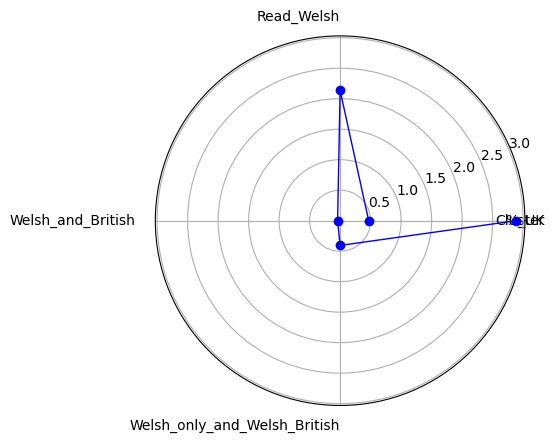

In [29]:
import numpy as np
# Now to create radial plots, first row first.
first_row_centers_cardiff = cluster_centers_cardiff.iloc[0, :]

# len of features
num_features = len(first_row_centers_cardiff)

# polar coordinates
theta = np.linspace(0, 2 * np.pi, num_features, endpoint=True)

fig, ax = plt.subplots(subplot_kw={'projection': 'polar'})
ax.plot(theta, first_row_centers_cardiff, linewidth=1, color='blue', marker='o', label='Centers')
# Add an extra red line at the 0.0 value
ax.plot(theta, np.zeros_like(first_row_centers_cardiff), color='red', linestyle='--', label='Avarage')

ax.set_xticks(theta)
ax.set_xticklabels(cluster_centers_cardiff.columns, rotation=45, ha='right')

plt.show()

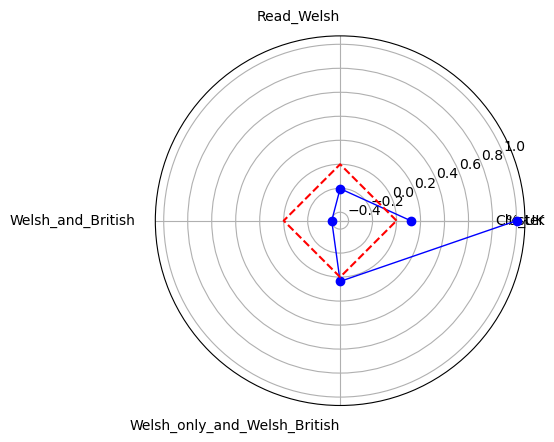

In [30]:
# Now to create radial plots, second row.
second_row_centers_cardiff = cluster_centers_cardiff.iloc[1, :]

# len of features
num_features = len(second_row_centers_cardiff)

# polar coordinates
theta = np.linspace(0, 2 * np.pi, num_features, endpoint=True)

fig, ax = plt.subplots(subplot_kw={'projection': 'polar'})
ax.plot(theta, second_row_centers_cardiff, linewidth=1, color='blue', marker='o', label='Centers')
# Add an extra red line at the 0.0 value
ax.plot(theta, np.zeros_like(second_row_centers_cardiff), color='red', linestyle='--', label='Avarage')

ax.set_xticks(theta)
ax.set_xticklabels(cluster_centers_cardiff.columns, rotation=45, ha='right')

plt.show()

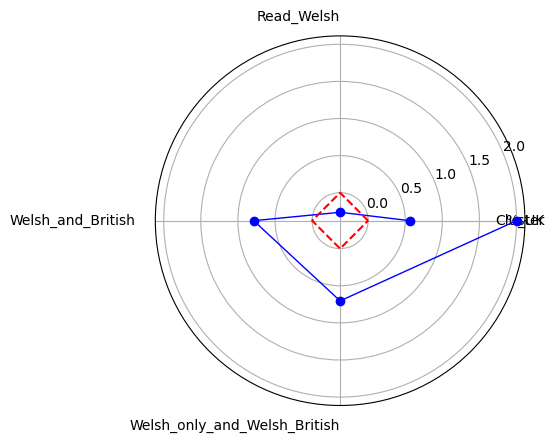

In [31]:
# Now to create radial plots, third row.
third_row_centers_cardiff = cluster_centers_cardiff.iloc[2, :]

# len of features
num_features = len(third_row_centers_cardiff)

# polar coordinates
theta = np.linspace(0, 2 * np.pi, num_features, endpoint=True)

fig, ax = plt.subplots(subplot_kw={'projection': 'polar'})
ax.plot(theta, third_row_centers_cardiff, linewidth=1, color='blue', marker='o', label='Centers')
# Add an extra red line at the 0.0 value
ax.plot(theta, np.zeros_like(third_row_centers_cardiff), color='red', linestyle='--', label='Avarage')

ax.set_xticks(theta)
ax.set_xticklabels(cluster_centers_cardiff.columns, rotation=45, ha='right')

plt.show()

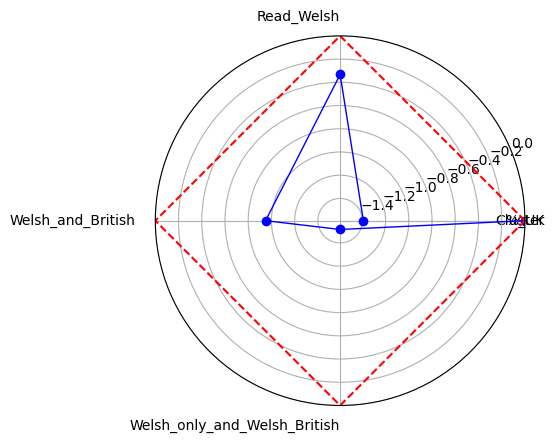

In [32]:
# Now to create radial plots, fourth row.
fourth_row_centers_cardiff = cluster_centers_cardiff.iloc[3, :]

# len of features
num_features = len(fourth_row_centers_cardiff)

# polar coordinates
theta = np.linspace(0, 2 * np.pi, num_features, endpoint=True)

fig, ax = plt.subplots(subplot_kw={'projection': 'polar'})
ax.plot(theta, fourth_row_centers_cardiff, linewidth=1, color='blue', marker='o', label='Centers')
# Add an extra red line at the 0.0 value
ax.plot(theta, np.zeros_like(fourth_row_centers_cardiff), color='red', linestyle='--', label='Avarage')

ax.set_xticks(theta)
ax.set_xticklabels(cluster_centers_cardiff.columns, rotation=45, ha='right')

plt.show()

In [33]:
# From these results, it seems that the % UK variable differs the most from the others with its higher
# Z score across three out of four of the radial plots. 
# Within each group, there seems to be a correlation between those who identify as either Welsh only
# or Welsh and British and the ability to read Welsh.

In [34]:
# Drop all but the clusters result from the z score
list(z_score_df_cardiff.columns)


['%_UK',
 'Read_Welsh',
 'Welsh_and_British',
 'Welsh_only_and_Welsh_British',
 'Cluster']

In [35]:
z_score_df_cardiff.drop([
 '%_UK',
 'Read_Welsh',
 'Welsh_and_British',
 'Welsh_only_and_Welsh_British'], axis=1, inplace=True)
z_score_df_cardiff.info() # Correctly dropped all but cluster. Now add it to cardiff_census_data_noperc

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1115 entries, 0 to 1114
Data columns (total 1 columns):
 #   Column   Non-Null Count  Dtype
---  ------   --------------  -----
 0   Cluster  1115 non-null   int32
dtypes: int32(1)
memory usage: 4.5 KB


In [36]:
final_df_cardiff = pd.concat([cardiff_census_data, z_score_df_cardiff], axis=1, ignore_index=False)
final_df_cardiff.head()

,OA21CD,LSOA21CD,LSOA21NM,LSOA21NMW,GlobalID,geometry,2021 output area,No_Spoken_Welsh,Spoken_Welsh,%_UK,No_Read_Welsh,Read_Welsh,Only_Welsh,Welsh_and_British,Welsh_only_and_Welsh_British,Cluster
0,W00008779,W01001694,Cardiff 036A,Caerdydd 036A,45935cda-b2a5-4103-b6a7-3b349972886d,"POLYGON ((319989.873 176997.771, 319972.767 17...",W00008779,87.3,12.7,89.7,92.5,7.5,42.4,9.2,51.6,1
1,W00008780,W01001697,Cardiff 036D,Caerdydd 036D,72e459d5-77e2-4765-9939-8874e049b212,"POLYGON ((320049.851 177250.509, 320052.056 17...",W00008780,88.3,11.7,75.9,91.4,8.6,33.9,4.7,38.6,0
2,W00008781,W01001694,Cardiff 036A,Caerdydd 036A,62dd9689-45bd-47e1-8133-0a1c03f26763,"POLYGON ((319653.520 177024.966, 319650.532 17...",W00008781,88.9,11.1,79.7,92.1,7.9,35.1,4.2,39.3,0
3,W00008782,W01001694,Cardiff 036A,Caerdydd 036A,85c9cf59-8d05-4477-8d15-887151c9eae2,"POLYGON ((319906.567 176957.413, 319906.492 17...",W00008782,94.0,6.0,82.0,95.1,4.9,35.6,5.0,40.6,0
4,W00008784,W01001694,Cardiff 036A,Caerdydd 036A,beb65b41-1085-46e6-9e68-2492d73b2c54,"POLYGON ((319989.873 176997.771, 319990.658 17...",W00008784,90.5,9.5,80.3,92.0,8.0,27.9,6.1,34.0,0


In [37]:
# Now for the map
final_df_cardiff.explore(column='Cluster', cmap='Set1', tiles='CartoDB positron')

### Outcome Screenshot:
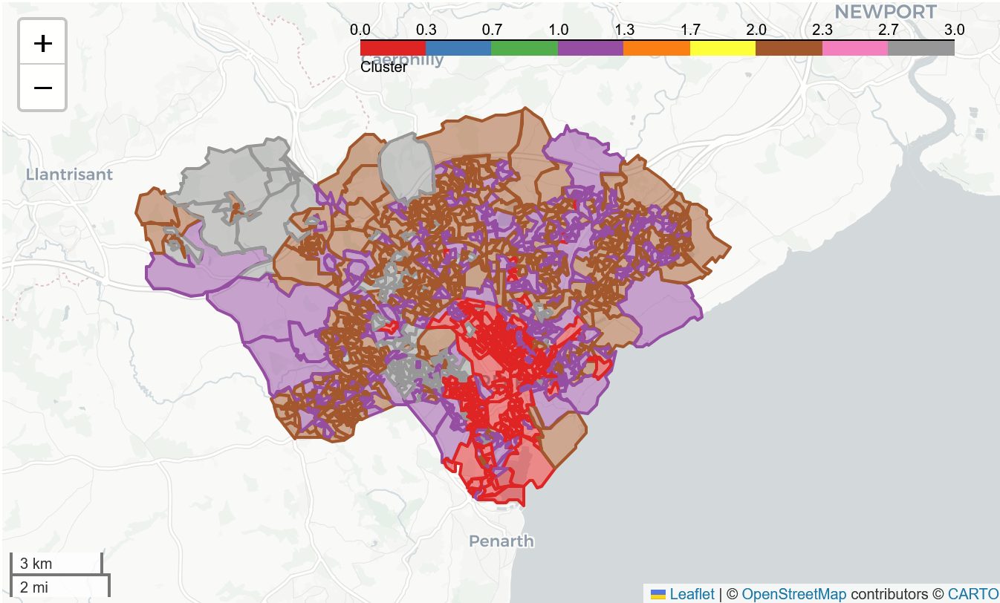

In [38]:
# renaming
# From the principal component graph above, cluster 0 is Low Welsh rates, cluster 3 is high Welsh rates,
# Cluster 2 is Medium Low Welsh Rates and Cluster 1 is Medium High Welsh Rates.
# Based off component 1 and 2 variations.
def rename_column(x): 
    x = str(x)  # Convert integer to string
    x = x.replace("3", "High Welsh Rates")
    x = x.replace("2", "Medium Low Welsh Rates")
    x = x.replace("1", "Medium High Welsh Rates")
    x = x.replace("0", "Low Welsh Rates")
    return x

final_df_cardiff['Cluster'] = final_df_cardiff['Cluster'].apply(rename_column)
final_df_cardiff.explore(column='Cluster', cmap='Set1', tiles='CartoDB positron')

### Outcome Screenshot:
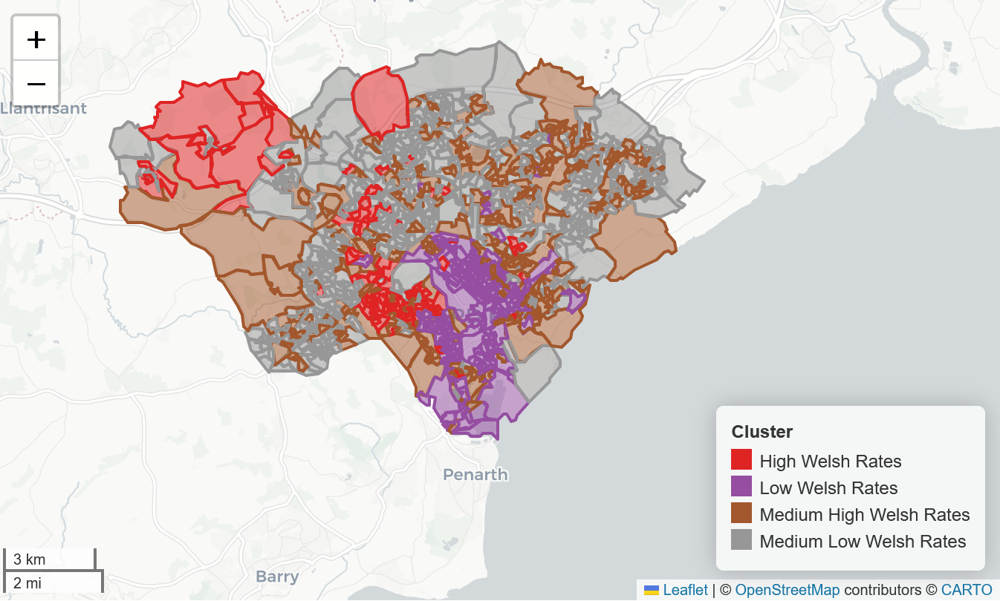

### Final Remarks on Challenge:
In this challenge, I have plotted the rates of indicators of Welsh identity (including national identity and ability to read and understand Welsh) in Cardiff. I chose this as it can be used to target the provision of Welsh language in these areas for use cases including Welsh language preservation within Cardiff and provision of Welsh public information resources. I decided to use the PCA cluster groups to analyse the results and the radial plots to define the clusters.

I classified cluster 0 (radial chart 4) as low Welsh rates due to the lower levels of Welsh literacy and Welsh identity, cluster 2 (radial chart 2) as medium low due to lower Welsh literacy and identity levels than cluster 1, cluster 1 (radial chart 3) is medium high due to higher Welsh and British identity than cluster 1 but low Welsh literacy rates compared to cluster 3 and cluster 3 (radial chart 1) as high Welsh rates due to high levels of Welsh literacy and national identity.

What I learned was that my Welsh identity markers (spoken and read Welsh ability) alongside indicators of "Welsh" identity were heavily correlated. Once sorted, I only had 4 variables (3 relating to "British" and "Welsh" identity and 1 relating to Welsh language ability). Next time, I would likely choose more diverse values so that I have less correlation occuring.

From the classified map above, I found that the city centre has lower rates of both Welsh understanding and Welsh national identity- leading it to be less of a target for Welsh language preservation. Conversely, the inner city area West of the city centre had a high Welsh-identifying population and high Welsh literacy rate- leading it to be more of a target for Welsh language preservation. On average, Western LSOAs had higher levels of Welsh identity and literacy than Eastern LSOAs- meaning Welsh language and culture preservation is more important within the Western side of the city. The larger, more rural LSOAs on the green belt also have on average higher Welsh identity and literacy than the inner suburbs.

Overall, outer suburbs and west of the city centre should be targeted for Welsh culture and language provision whereas the city centre should be less of a priority.
